# Caso 3: Aseguradora

## 1. Entendimiento del Problema

El equipo de tarifación de la aseguradora requiere pronósticar el valor de la prima de los aseguradores dentro de la compañía

## 2. Enfoque Analítico

Se debe construir un modelo de regresión que permita predecir la prima con un MAPE menor o igual al 15%

## 3. Requerimiento de Datos

- Se requieren los datos de los aseguradores dentro de la compañía

## 4. Recolección de Datos

- age: edad del asegurado
- sex: género del asegurado
- bmi: índice de masa corporal del asegurado
- children: número de hijos del asegurado
- smoker: el asegurado es o no es fumador
- region: región comercial a la que pertenece el asegurado
- charges: valor de la prima del asegurado

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import numpy as np

import warnings
warnings.filterwarnings('ignore')

In [3]:
data = pd.read_csv('datos_caso_3.csv')
data

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
...,...,...,...,...,...,...,...
1333,50,male,30.970,3,no,northwest,10600.54830
1334,18,female,31.920,0,no,northeast,2205.98080
1335,18,female,36.850,0,no,southeast,1629.83350
1336,21,female,25.800,0,no,southwest,2007.94500


## 5. Entendimiento de los Datos

### Valores Nulos

<Axes: >

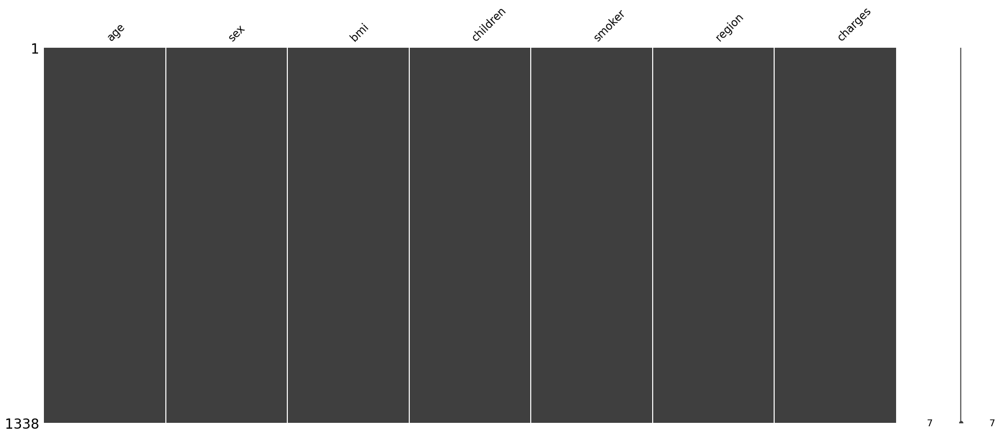

In [106]:
msno.matrix(data)

In [107]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


### Análisis Variable Y

- Posee un comportamiento normal al tratarse de temas financieros con una curva exponencial

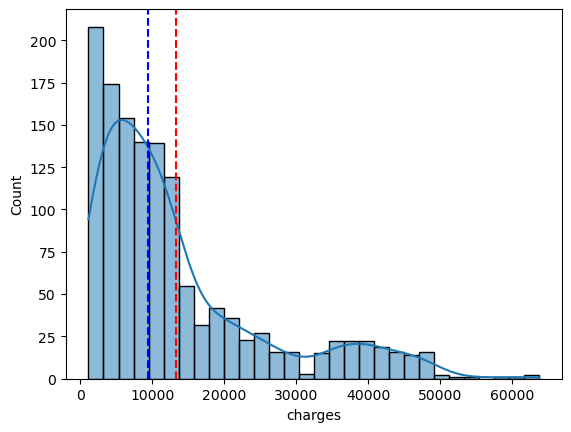

In [108]:
sns.histplot(data, x = "charges", kde=True)
plt.axvline(data["charges"].mean(), color='red', linestyle='--')
plt.axvline(data["charges"].median(), color='blue', linestyle='--')
plt.show()

### Histogramas de Frecuencia

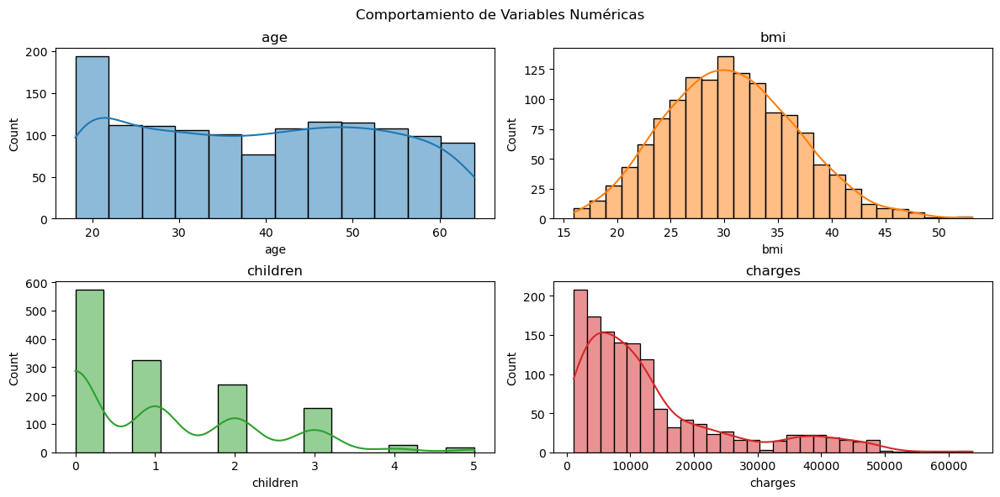

In [109]:
fig, ax = plt.subplots(2, 2, figsize = (12, 6))
ax = ax.flat
num_col = data.select_dtypes(include = ['int64', 'float64']).columns
for i, col in enumerate(num_col):
    sns.histplot(data = data, x = col, 
                kde = True, color = (list(plt.rcParams['axes.prop_cycle']) * 7)[i]['color'], ax = ax[i])
    ax[i].set_title(col)
fig.tight_layout()
fig.subplots_adjust(top = 0.9)
fig.suptitle('Comportamiento de Variables Numéricas')
plt.show()

### Gráficos de Torta

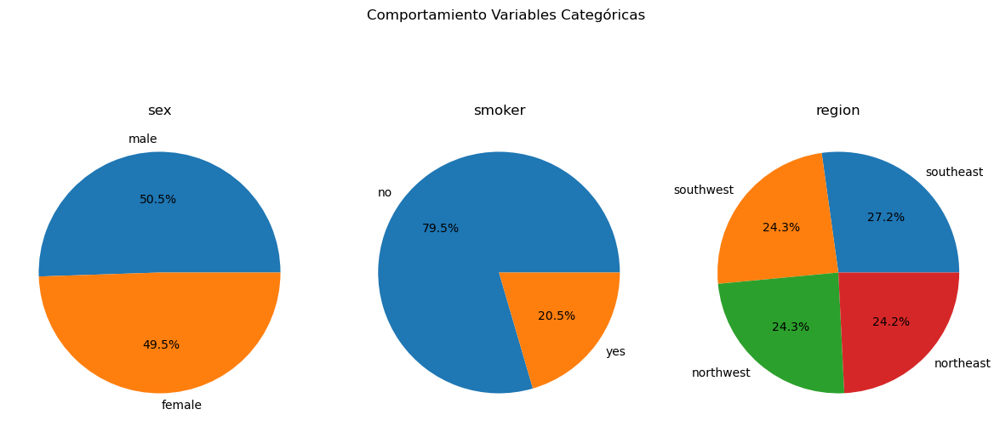

In [110]:
fig, ax = plt.subplots(1, 3, figsize = (12, 6))
ax = ax.flat
cat_col = data.select_dtypes(include = ['object']).columns
for i, col in enumerate(cat_col):
    ax[i].pie(x = data[col].value_counts(), labels = data[col].value_counts().index, autopct = '%0.1f%%')
    ax[i].set_title(col)
fig.tight_layout()
fig.subplots_adjust(top = 0.9)
fig.suptitle("Comportamiento Variables Categóricas")
plt.show()

### Factor de Correlación

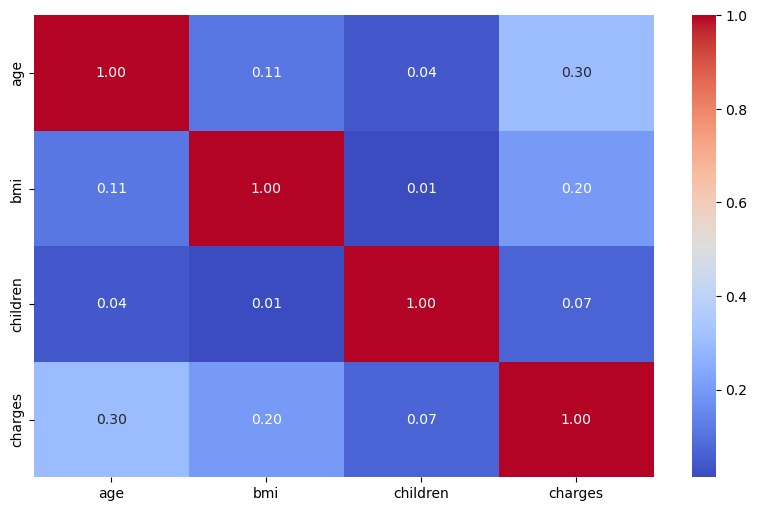

In [111]:
plt.figure(figsize = (10, 6))
sns.heatmap(data.corr(numeric_only=True), annot=True, fmt=".2f", cmap="coolwarm")
plt.show()

## 6. Preparación de los datos

In [112]:
data_clean = data.copy()
data_clean

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520
...,...,...,...,...,...,...,...
1333,50,male,30.970,3,no,northwest,10600.54830
1334,18,female,31.920,0,no,northeast,2205.98080
1335,18,female,36.850,0,no,southeast,1629.83350
1336,21,female,25.800,0,no,southwest,2007.94500


In [113]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
from sklearn.pipeline import Pipeline

### Transformación de los Datos

In [114]:
num_col = data_clean.select_dtypes(include = ['int64', 'float64']).columns
cat_col = data_clean.select_dtypes(include = ['object']).columns

num_trans = Pipeline(steps = [('scaler', MinMaxScaler())])
cat_trans = Pipeline(steps = [('onehot', OneHotEncoder())])

preprocessor = ColumnTransformer(transformers = [
    ('num', num_trans, num_col),
    ('cat', cat_trans, cat_col)
])

preprocessor

ColumnTransformer(transformers=[('num',
                                 Pipeline(steps=[('scaler', MinMaxScaler())]),
                                 Index(['age', 'bmi', 'children', 'charges'], dtype='object')),
                                ('cat',
                                 Pipeline(steps=[('onehot', OneHotEncoder())]),
                                 Index(['sex', 'smoker', 'region'], dtype='object'))])

In [115]:
data_pre = preprocessor.fit_transform(data_clean)
cod_cat = preprocessor.named_transformers_['cat']['onehot'].get_feature_names_out(cat_col)
labels = np.concatenate([num_col, cod_cat])
data_pro = pd.DataFrame(data_pre, columns = labels)
data_pro = data_pro[(data_pro['charges'] != 0)]
data_pro

,age,bmi,children,charges,sex_female,sex_male,smoker_no,smoker_yes,region_northeast,region_northwest,region_southeast,region_southwest
0,0.021739,0.321227,0.0,0.251611,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
1,0.000000,0.479150,0.2,0.009636,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
2,0.217391,0.458434,0.6,0.053115,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
3,0.326087,0.181464,0.0,0.333010,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
4,0.304348,0.347592,0.0,0.043816,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
1333,0.695652,0.403820,0.6,0.151299,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
1334,0.000000,0.429379,0.0,0.017305,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0
1335,0.000000,0.562012,0.0,0.008108,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
1336,0.065217,0.264730,0.0,0.014144,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0


### Conjunto de Entrenamiento

- Debido a que la evaluación se va a realizar mediante MAPE se eliminó el único registro que tenía un 0 dentro de la variable Y (Charges) para poder medirlo bien y que no tienda a infinito

In [116]:
from sklearn.model_selection import train_test_split

El tamaño del conjunto de entrenamiento es: 935 935
El tamaño del conjunto de prueba es: 402 402


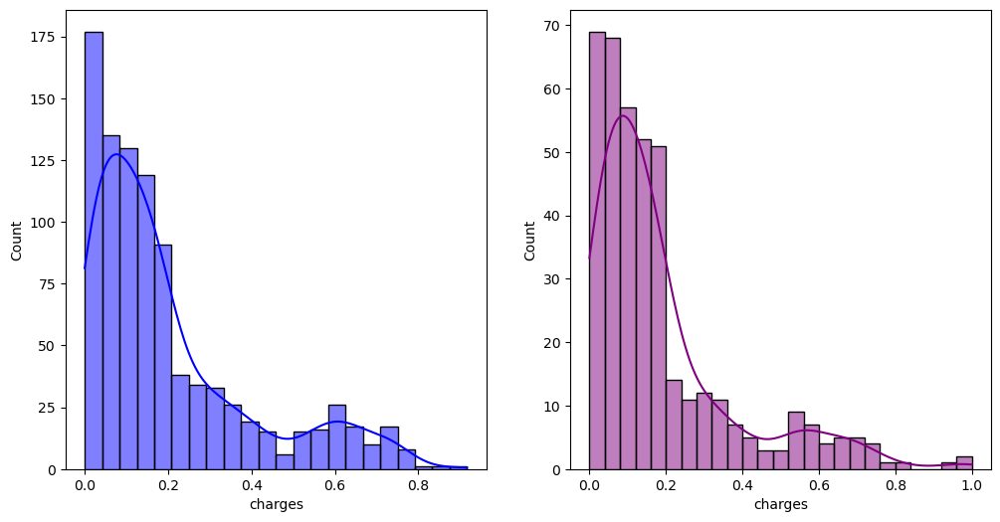

In [117]:
X = data_pro.drop(columns = ['charges'])
y = data_pro['charges']

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.7, random_state = 123)
print(f'El tamaño del conjunto de entrenamiento es: {X_train.shape[0]} {y_train.shape[0]}')
print(f'El tamaño del conjunto de prueba es: {X_test.shape[0]} {y_test.shape[0]}')
fig, ax = plt.subplots(1, 2, figsize = (12, 6))
sns.histplot(y_train, kde = True, color = 'blue', ax = ax[0])
sns.histplot(y_test, kde = True, color = 'purple', ax = ax[1])
plt.show()

## 7. Modelos

In [118]:
from sklearn.metrics import r2_score, mean_absolute_error, root_mean_squared_error, mean_absolute_percentage_error
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

### Regresión Lineal

In [119]:
from sklearn.linear_model import LinearRegression

In [120]:
modelo_1 = LinearRegression()
modelo_1.fit(X_train, y_train)

LinearRegression()

In [121]:
modelo_1.intercept_

np.float64(0.13204452282257112)

In [122]:
modelo_1.coef_

array([ 0.18460145,  0.2027336 ,  0.03797826,  0.00131335, -0.00131335,
       -0.1873719 ,  0.1873719 ,  0.01340373, -0.00103178, -0.00363379,
       -0.00873816])

In [123]:
pred_train_1 = modelo_1.predict(X_train)
pred_test_1 = modelo_1.predict(X_test)
# Desecalamiento con fórmula matemática
pred_train_desc_1 = pred_train_1 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_1 = pred_test_1 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.7439065287708758
MAE entrenamiento: 0.06924370181607171
RMSE entrenamiento: 0.09864241836010941
MAPE entrenamiento: 1.3906403989738654


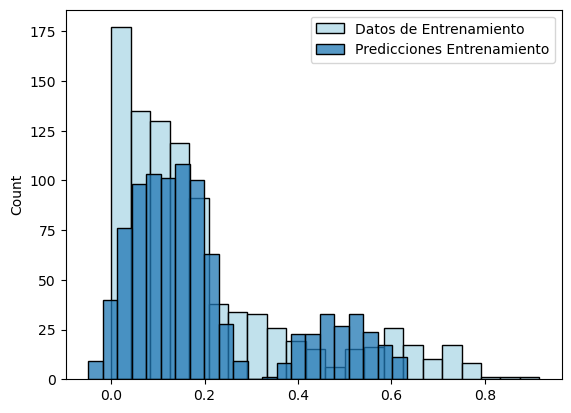

In [124]:
r2_train_1 = r2_score(y_train_desc, pred_train_desc_1)
mae_train_1 = mean_absolute_error(y_train_desc, pred_train_desc_1)
rmse_train_1 = root_mean_squared_error(y_train_desc, pred_train_desc_1)
mape_train_1 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_1)

print(f'R2 entrenamiento: {r2_train_1}')
print(f'MAE entrenamiento: {mae_train_1}')
print(f'RMSE entrenamiento: {rmse_train_1}')
print(f'MAPE entrenamiento: {mape_train_1}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_1.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.7646220339909666
MAE prueba: 0.06326889690578752
RMSE prueba: 0.09157340906723709
MAPE prueba: 1.6543121432377708


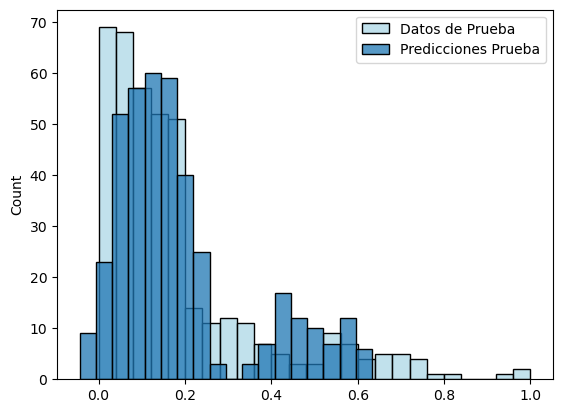

In [125]:
r2_test_1 = r2_score(y_test_desc, pred_test_desc_1)
mae_test_1 = mean_absolute_error(y_test_desc, pred_test_desc_1)
rmse_test_1 = root_mean_squared_error(y_test_desc, pred_test_desc_1)
mape_test_1 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_1)

print(f'R2 prueba: {r2_test_1}')
print(f'MAE prueba: {mae_test_1}')
print(f'RMSE prueba: {rmse_test_1}')
print(f'MAPE prueba: {mape_test_1}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_1.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### K Vecinos Mas Cercanos

In [126]:
from sklearn.neighbors import KNeighborsRegressor

In [127]:
modelo_2 = KNeighborsRegressor()
param_grid = {'n_neighbors': [2, 3, 5, 7, 11, 21, 35, 60, 100], 'p': [1, 2]}
reg_2 = GridSearchCV(modelo_2, param_grid, cv = 5, n_jobs = -1, scoring = 'neg_mean_absolute_percentage_error')
reg_2.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=KNeighborsRegressor(), n_jobs=-1,
             param_grid={'n_neighbors': [2, 3, 5, 7, 11, 21, 35, 60, 100],
                         'p': [1, 2]},
             scoring='neg_mean_absolute_percentage_error')

In [128]:
validation = pd.concat([pd.DataFrame(reg_2.cv_results_['params']), 
                        pd.DataFrame(reg_2.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,n_neighbors,p,MAPE
4,5,1,-1.279368
2,3,1,-1.283858
3,3,2,-1.295474
8,11,1,-1.404977
6,7,1,-1.456053
7,7,2,-1.464642
5,5,2,-1.510943
9,11,2,-1.555599
0,2,1,-1.583698
1,2,2,-1.592702


In [129]:
modelo_2_final = reg_2.best_estimator_
modelo_2_final

KNeighborsRegressor(p=1)

In [130]:
pred_train_2 = modelo_2_final.predict(X_train)
pred_test_2 = modelo_2_final.predict(X_test)
# Desecalamiento con fórmula matemática
pred_train_desc_2 = pred_train_2 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_2 = pred_test_2 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.837004791607159
MAE entrenamiento: 0.048703834544088255
RMSE entrenamiento: 0.07869585830561449
MAPE entrenamiento: 0.743306908183118


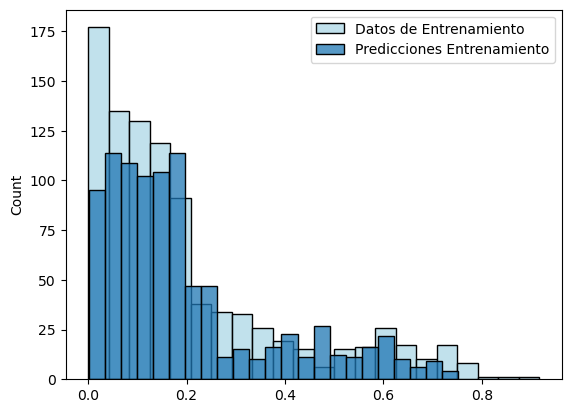

In [131]:
r2_train_2 = r2_score(y_train_desc, pred_train_desc_2)
mae_train_2 = mean_absolute_error(y_train_desc, pred_train_desc_2)
rmse_train_2 = root_mean_squared_error(y_train_desc, pred_train_desc_2)
mape_train_2 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_2)

print(f'R2 entrenamiento: {r2_train_2}')
print(f'MAE entrenamiento: {mae_train_2}')
print(f'RMSE entrenamiento: {rmse_train_2}')
print(f'MAPE entrenamiento: {mape_train_2}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_2.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.7612115972032654
MAE prueba: 0.05638404178623549
RMSE prueba: 0.09223443564372151
MAPE prueba: 0.7432725719937843


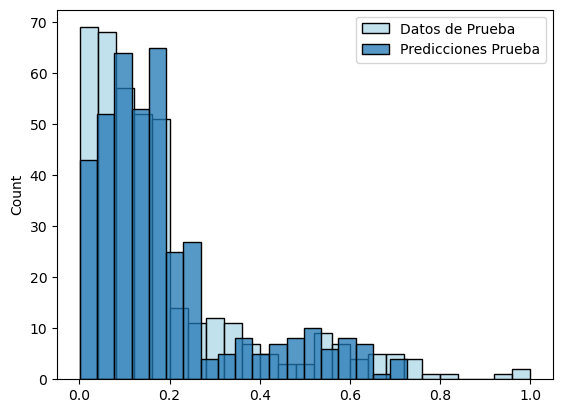

In [132]:
r2_test_2 = r2_score(y_test_desc, pred_test_desc_2)
mae_test_2 = mean_absolute_error(y_test_desc, pred_test_desc_2)
rmse_test_2 = root_mean_squared_error(y_test_desc, pred_test_desc_2)
mape_test_2 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_2)

print(f'R2 prueba: {r2_test_2}')
print(f'MAE prueba: {mae_test_2}')
print(f'RMSE prueba: {rmse_test_2}')
print(f'MAPE prueba: {mape_test_2}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_2.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### MSV

In [133]:
from sklearn.svm import SVR

In [134]:
modelo_3 = SVR()
param_grid = {'C': [0.01, 0.1, 1, 10, 100], 'kernel': ['linear', 'poly', 'rbf'], 'degree': [2, 3, 4]}
reg_3 = GridSearchCV(modelo_3, param_grid, cv = 5, n_jobs = -1, scoring = 'neg_mean_absolute_percentage_error')
reg_3.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_3.cv_results_['params']), 
                        pd.DataFrame(reg_3.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,C,degree,kernel,MAPE
33,10.00,4,linear,-2.658024
27,10.00,2,linear,-2.658024
30,10.00,3,linear,-2.658024
42,100.00,4,linear,-2.680395
39,100.00,3,linear,-2.680395
36,100.00,2,linear,-2.680395
18,1.00,2,linear,-2.725386
24,1.00,4,linear,-2.725386
21,1.00,3,linear,-2.725386
15,0.10,4,linear,-2.947813


In [135]:
modelo_3_final = reg_3.best_estimator_
modelo_3_final

SVR(C=10, degree=2, kernel='linear')

In [136]:
pred_train_3 = modelo_3_final.predict(X_train)
pred_test_3 = modelo_3_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_3 = pred_train_3 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_3 = pred_test_3 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.7308134994633539
MAE entrenamiento: 0.07690557148629441
RMSE entrenamiento: 0.1011325821568963
MAPE entrenamiento: 1.9558831175162474


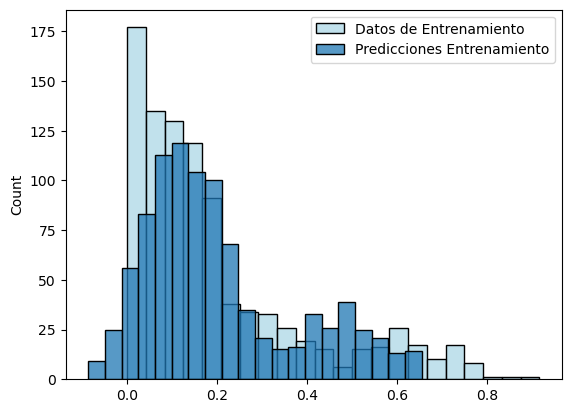

In [137]:
r2_train_3 = r2_score(y_train_desc, pred_train_desc_3)
mae_train_3 = mean_absolute_error(y_train_desc, pred_train_desc_3)
rmse_train_3 = root_mean_squared_error(y_train_desc, pred_train_desc_3)
mape_train_3 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_3)

print(f'R2 entrenamiento: {r2_train_3}')
print(f'MAE entrenamiento: {mae_train_3}')
print(f'RMSE entrenamiento: {rmse_train_3}')
print(f'MAPE entrenamiento: {mape_train_3}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_3.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.7612115972032654
MAE prueba: 0.07261681896021306
RMSE prueba: 0.09528146786807518
MAPE prueba: 2.4177639791044987


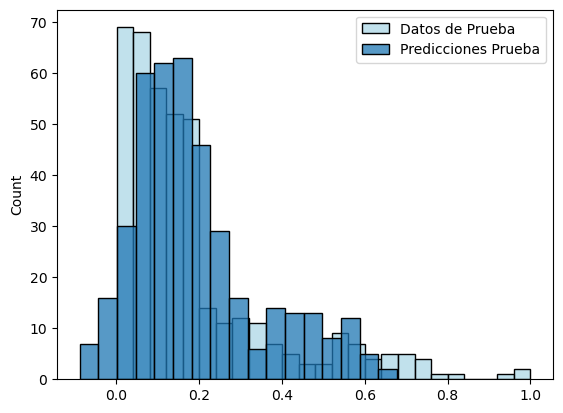

In [138]:
r2_test_3 = r2_score(y_test_desc, pred_test_desc_2)
mae_test_3 = mean_absolute_error(y_test_desc, pred_test_desc_3)
rmse_test_3 = root_mean_squared_error(y_test_desc, pred_test_desc_3)
mape_test_3 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_3)

print(f'R2 prueba: {r2_test_3}')
print(f'MAE prueba: {mae_test_3}')
print(f'RMSE prueba: {rmse_test_3}')
print(f'MAPE prueba: {mape_test_3}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_3.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Árboles de Decisión

In [139]:
from sklearn.tree import DecisionTreeRegressor

In [140]:
modelo_4 = DecisionTreeRegressor(random_state=123)
param_grid = {'criterion': ['friedman_mse', 'poisson', 'squared_error', 'absolute_error'], 'max_depth': [None, 5, 10, 20], 'min_samples_split': [2, 3], 'max_leaf_nodes': [None, 2, 3, 4]}
reg_4 = GridSearchCV(modelo_4, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error')
reg_4.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_4.cv_results_['params']), 
                        pd.DataFrame(reg_4.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,max_depth,max_leaf_nodes,min_samples_split,MAPE
105,absolute_error,5.0,NaN,3,-0.580615
104,absolute_error,5.0,NaN,2,-0.580615
113,absolute_error,10.0,NaN,3,-0.615177
112,absolute_error,10.0,NaN,2,-0.633725
24,friedman_mse,20.0,NaN,2,-0.725528
...,...,...,...,...,...
75,squared_error,5.0,2.0,3,-4.893524
83,squared_error,10.0,2.0,3,-4.893524
82,squared_error,10.0,2.0,2,-4.893524
27,friedman_mse,20.0,2.0,3,-4.893524


In [141]:
modelo_4_final = reg_4.best_estimator_
modelo_4_final

DecisionTreeRegressor(criterion='absolute_error', max_depth=5, random_state=123)

In [142]:
pred_train_4 = modelo_4_final.predict(X_train)
pred_test_4 = modelo_4_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_4 = pred_train_4 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_4 = pred_test_4 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.8537791374839994
MAE entrenamiento: 0.029751812332088266
RMSE entrenamiento: 0.07453652274724495
MAPE entrenamiento: 0.3846167298220479


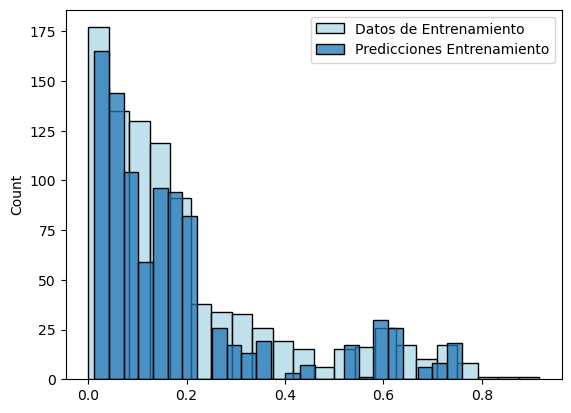

In [143]:
r2_train_4 = r2_score(y_train_desc, pred_train_desc_4)
mae_train_4 = mean_absolute_error(y_train_desc, pred_train_desc_4)
rmse_train_4 = root_mean_squared_error(y_train_desc, pred_train_desc_4)
mape_train_4 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_4)

print(f'R2 entrenamiento: {r2_train_4}')
print(f'MAE entrenamiento: {mae_train_4}')
print(f'RMSE entrenamiento: {rmse_train_4}')
print(f'MAPE entrenamiento: {mape_train_4}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_4.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.8714135115724613
MAE prueba: 0.029228166914756347
RMSE prueba: 0.06768370869302197
MAPE prueba: 0.38032567532645567


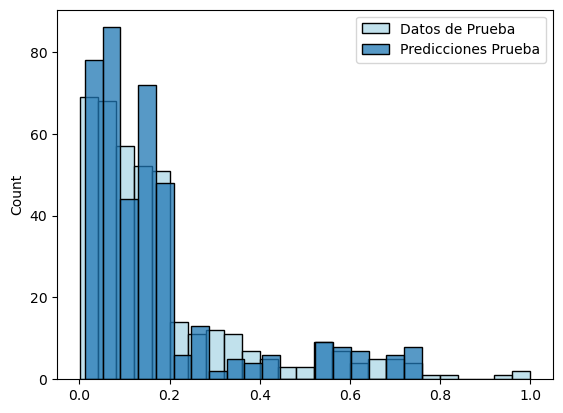

In [144]:
r2_test_4 = r2_score(y_test_desc, pred_test_desc_4)
mae_test_4 = mean_absolute_error(y_test_desc, pred_test_desc_4)
rmse_test_4 = root_mean_squared_error(y_test_desc, pred_test_desc_4)
mape_test_4 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_4)

print(f'R2 prueba: {r2_test_4}')
print(f'MAE prueba: {mae_test_4}')
print(f'RMSE prueba: {rmse_test_4}')
print(f'MAPE prueba: {mape_test_4}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_4.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Bosques Aleatorios

In [145]:
from sklearn.ensemble import RandomForestRegressor

In [146]:
modelo_5 = RandomForestRegressor(random_state=123)
param_grid = {'criterion': ['friedman_mse', 'poisson', 'squared_error', 'absolute_error'],
              'max_depth': [None, 5, 10, 20], 'max_leaf_nodes': [None, 2, 3, 4], 'n_estimators': [100, 200, 300]}
reg_5 = GridSearchCV(modelo_5, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)
reg_5.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_5.cv_results_['params']), 
                        pd.DataFrame(reg_5.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,max_depth,max_leaf_nodes,n_estimators,MAPE
156,absolute_error,5.0,NaN,100,-0.577937
158,absolute_error,5.0,NaN,300,-0.582695
157,absolute_error,5.0,NaN,200,-0.584975
168,absolute_error,10.0,NaN,100,-0.709222
169,absolute_error,10.0,NaN,200,-0.720380
...,...,...,...,...,...
113,squared_error,5.0,2.0,300,-4.908037
77,poisson,10.0,2.0,300,-4.908037
101,squared_error,NaN,2.0,300,-4.908037
29,friedman_mse,10.0,2.0,300,-4.908037


In [147]:
modelo_5_final = reg_5.best_estimator_
modelo_5_final

RandomForestRegressor(criterion='absolute_error', max_depth=5, random_state=123)

In [148]:
pred_train_5 = modelo_5_final.predict(X_train)
pred_test_5 = modelo_5_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_5 = pred_train_5 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_5 = pred_test_5 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.8654053121973153
MAE entrenamiento: 0.02788045059449952
RMSE entrenamiento: 0.07151191653346285
MAPE entrenamiento: 0.3725654568537175


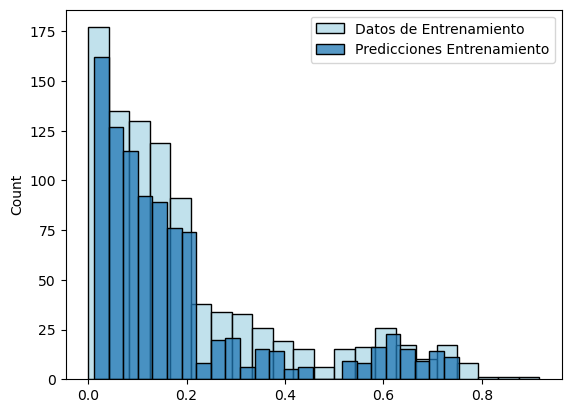

In [149]:
r2_train_5 = r2_score(y_train_desc, pred_train_desc_5)
mae_train_5 = mean_absolute_error(y_train_desc, pred_train_desc_5)
rmse_train_5 = root_mean_squared_error(y_train_desc, pred_train_desc_5)
mape_train_5 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_5)

print(f'R2 entrenamiento: {r2_train_5}')
print(f'MAE entrenamiento: {mae_train_5}')
print(f'RMSE entrenamiento: {rmse_train_5}')
print(f'MAPE entrenamiento: {mape_train_5}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_5.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.8714135115724613
MAE prueba: 0.02778544066800538
RMSE prueba: 0.06679255097261118
MAPE prueba: 0.3731729650167707


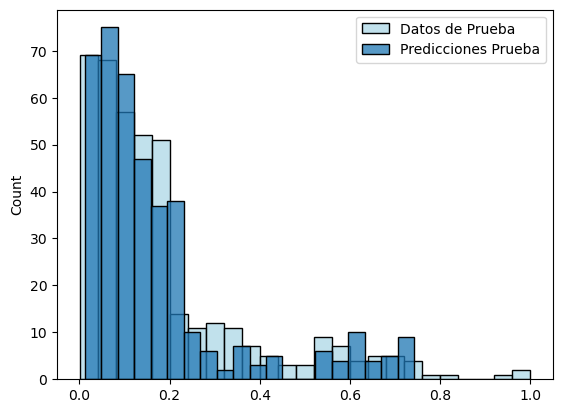

In [150]:
r2_test_5 = r2_score(y_test_desc, pred_test_desc_4)
mae_test_5 = mean_absolute_error(y_test_desc, pred_test_desc_5)
rmse_test_5 = root_mean_squared_error(y_test_desc, pred_test_desc_5)
mape_test_5 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_5)

print(f'R2 prueba: {r2_test_5}')
print(f'MAE prueba: {mae_test_5}')
print(f'RMSE prueba: {rmse_test_5}')
print(f'MAPE prueba: {mape_test_5}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_5.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Adaptative Boosting

In [151]:
from sklearn.ensemble import AdaBoostRegressor

In [152]:
modelo_6 = AdaBoostRegressor()
param_grid = {'estimator': [DecisionTreeRegressor(), KNeighborsRegressor()], 'n_estimators': [100, 200, 400], 'loss': ['linear', 'square', 'exponential'], 'learning_rate': [0.001, 0.1, 1, 10]}
reg_6 = GridSearchCV(modelo_6, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error')
reg_6.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_6.cv_results_['params']), 
                        pd.DataFrame(reg_6.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,estimator,learning_rate,loss,n_estimators,MAPE
3,DecisionTreeRegressor(),0.001,square,100,-0.358750
0,DecisionTreeRegressor(),0.001,linear,100,-0.361243
4,DecisionTreeRegressor(),0.001,square,200,-0.365008
2,DecisionTreeRegressor(),0.001,linear,400,-0.365258
6,DecisionTreeRegressor(),0.001,exponential,100,-0.367702
...,...,...,...,...,...
32,DecisionTreeRegressor(),10.000,square,400,-39.896358
31,DecisionTreeRegressor(),10.000,square,200,-39.896358
66,KNeighborsRegressor(),10.000,square,100,-39.896358
67,KNeighborsRegressor(),10.000,square,200,-39.896358


In [153]:
modelo_6_final = reg_6.best_estimator_
modelo_6_final

AdaBoostRegressor(estimator=DecisionTreeRegressor(), learning_rate=0.001,
                  loss='square', n_estimators=100)

In [154]:
pred_train_6 = modelo_6_final.predict(X_train)
pred_test_6 = modelo_6_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_6 = pred_train_6 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_6 = pred_test_6 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.9994397545118756
MAE entrenamiento: 0.00021338448245660432
RMSE entrenamiento: 0.004613745573030124
MAPE entrenamiento: 0.013379819124091143


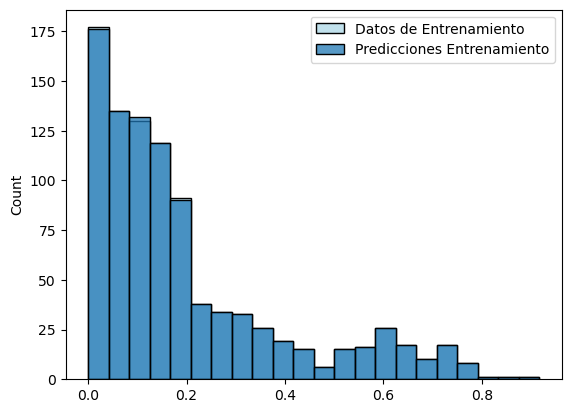

In [155]:
r2_train_6 = r2_score(y_train_desc, pred_train_desc_6)
mae_train_6 = mean_absolute_error(y_train_desc, pred_train_desc_6)
rmse_train_6 = root_mean_squared_error(y_train_desc, pred_train_desc_6)
mape_train_6 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_6)

print(f'R2 entrenamiento: {r2_train_6}')
print(f'MAE entrenamiento: {mae_train_6}')
print(f'RMSE entrenamiento: {rmse_train_6}')
print(f'MAPE entrenamiento: {mape_train_6}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_6.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.85666824589329
MAE prueba: 0.027245054687062637
RMSE prueba: 0.07145912389952155
MAPE prueba: 0.15523746613893655


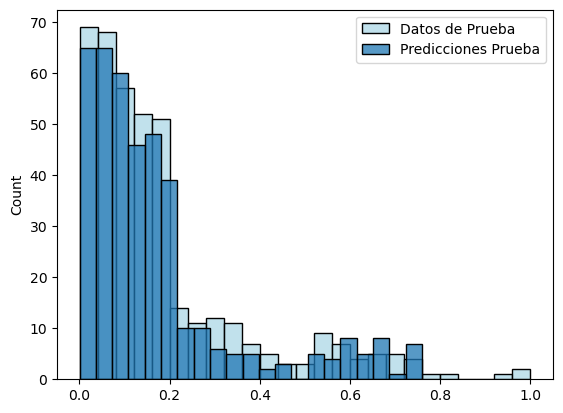

In [156]:
r2_test_6 = r2_score(y_test_desc, pred_test_desc_6)
mae_test_6 = mean_absolute_error(y_test_desc, pred_test_desc_6)
rmse_test_6 = root_mean_squared_error(y_test_desc, pred_test_desc_6)
mape_test_6 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_6)

print(f'R2 prueba: {r2_test_6}')
print(f'MAE prueba: {mae_test_6}')
print(f'RMSE prueba: {rmse_test_6}')
print(f'MAPE prueba: {mape_test_6}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_6.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### GradientBoosting

In [157]:
from sklearn.ensemble import GradientBoostingRegressor

In [158]:
modelo_7 = GradientBoostingRegressor()
# loss: ['squared_error', 'absolute_error', 'huber', 'quantile']
param_grid = {'loss': ['squared_error', 'absolute_error', 'huber', 'quantile'], 'n_estimators': [100, 200, 300, 900], 'criterion': ['friedman_mse', 'squared_error']}
reg_7 = GridSearchCV(modelo_7, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error')
reg_7.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_7.cv_results_['params']), 
                        pd.DataFrame(reg_7.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,criterion,loss,n_estimators,MAPE
5,friedman_mse,absolute_error,200,-0.166672
21,squared_error,absolute_error,200,-0.177030
23,squared_error,absolute_error,900,-0.183983
22,squared_error,absolute_error,300,-0.197590
4,friedman_mse,absolute_error,100,-0.234586
20,squared_error,absolute_error,100,-0.242291
7,friedman_mse,absolute_error,900,-0.282564
6,friedman_mse,absolute_error,300,-0.286391
24,squared_error,huber,100,-0.289451
8,friedman_mse,huber,100,-0.289508


In [159]:
modelo_7_final = reg_7.best_estimator_
modelo_7_final

GradientBoostingRegressor(loss='absolute_error', n_estimators=200)

In [160]:
pred_train_7 = modelo_7_final.predict(X_train)
pred_test_7 = modelo_7_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_7 = pred_train_7 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_7 = pred_test_7 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.8374413623887422
MAE entrenamiento: 0.031545879275802303
RMSE entrenamiento: 0.07859039708136491
MAPE entrenamiento: 0.11400764415825193


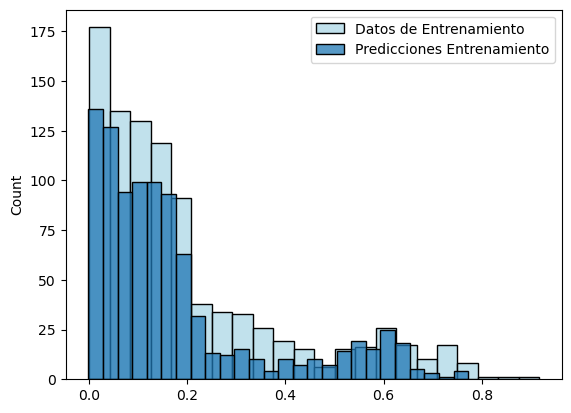

In [161]:
r2_train_7 = r2_score(y_train_desc, pred_train_desc_7)
mae_train_7 = mean_absolute_error(y_train_desc, pred_train_desc_7)
rmse_train_7 = root_mean_squared_error(y_train_desc, pred_train_desc_7)
mape_train_7 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_7)

print(f'R2 entrenamiento: {r2_train_7}')
print(f'MAE entrenamiento: {mae_train_7}')
print(f'RMSE entrenamiento: {rmse_train_7}')
print(f'MAPE entrenamiento: {mape_train_7}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_7.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.8362527033381507
MAE prueba: 0.03045282501691648
RMSE prueba: 0.07637892628676314
MAPE prueba: 0.17031559750782738


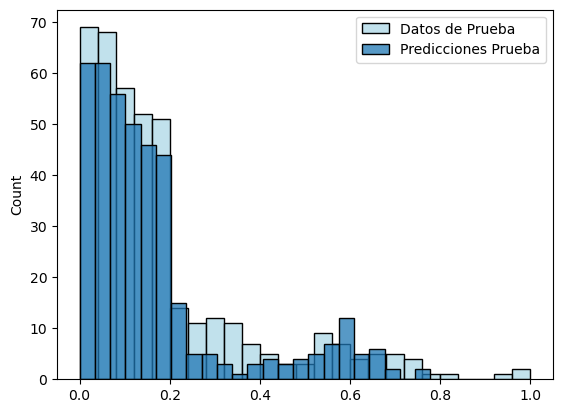

In [162]:
r2_test_7 = r2_score(y_test_desc, pred_test_desc_7)
mae_test_7 = mean_absolute_error(y_test_desc, pred_test_desc_7)
rmse_test_7 = root_mean_squared_error(y_test_desc, pred_test_desc_7)
mape_test_7 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_7)

print(f'R2 prueba: {r2_test_7}')
print(f'MAE prueba: {mae_test_7}')
print(f'RMSE prueba: {rmse_test_7}')
print(f'MAPE prueba: {mape_test_7}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_7.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### CatBoost Regressor

In [163]:
from catboost import CatBoostRegressor

In [164]:
modelo_8 = CatBoostRegressor()
param_grid = {'iterations': [100, 200, 500], 'depth': [4, 6, 8], 'learning_rate': [0.01, 0.1, 0.5, 1], 'l2_leaf_reg': [1, 3, 5]}
reg_8 = GridSearchCV(modelo_8, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)
reg_8.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_8.cv_results_['params']), 
                        pd.DataFrame(reg_8.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

0:	learn: 0.1902044	total: 59.4ms	remaining: 5.88s
0:	learn: 0.1284932	total: 59.2ms	remaining: 5.87s
0:	learn: 0.1768253	total: 59.4ms	remaining: 5.88s
0:	learn: 0.1872366	total: 59.4ms	remaining: 5.88s
0:	learn: 0.1744377	total: 59.3ms	remaining: 5.87s
0:	learn: 0.2022446	total: 59.5ms	remaining: 5.89s
1:	learn: 0.1647608	total: 59.7ms	remaining: 2.92s
1:	learn: 0.1622432	total: 59.6ms	remaining: 2.92s
1:	learn: 0.1858718	total: 59.9ms	remaining: 2.93s
1:	learn: 0.2006992	total: 59.8ms	remaining: 2.93s
2:	learn: 0.1531540	total: 59.9ms	remaining: 1.94s
2:	learn: 0.1503598	total: 59.9ms	remaining: 1.94s
3:	learn: 0.1436375	total: 60.1ms	remaining: 1.44s
2:	learn: 0.1990767	total: 60.1ms	remaining: 1.94s
2:	learn: 0.1844062	total: 60.2ms	remaining: 1.95s
3:	learn: 0.1408672	total: 60.1ms	remaining: 1.44s
1:	learn: 0.0966089	total: 60.3ms	remaining: 2.96s
3:	learn: 0.1975434	total: 60.3ms	remaining: 1.45s
3:	learn: 0.1830620	total: 60.4ms	remaining: 1.45s
4:	learn: 0.1346464	total: 60.5

,depth,iterations,l2_leaf_reg,learning_rate,MAPE
5,4,100,3,0.10,-1.238940
21,4,200,5,0.10,-1.248385
13,4,200,1,0.10,-1.260756
17,4,200,3,0.10,-1.272988
57,6,200,5,0.10,-1.273305
...,...,...,...,...,...
4,4,100,3,0.01,-4.897780
0,4,100,1,0.01,-4.912387
44,6,100,5,0.01,-5.002480
80,8,100,5,0.01,-5.008371


In [165]:
modelo_8_final = reg_8.best_estimator_
modelo_8_final

In [166]:
pred_train_8 = modelo_8_final.predict(X_train)
pred_test_8 = modelo_8_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_8 = pred_train_8 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_8 = pred_test_8 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.8828175231644846
MAE entrenamiento: 0.03792340641137472
RMSE entrenamiento: 0.0667261080337732
MAPE entrenamiento: 0.7797335800004629


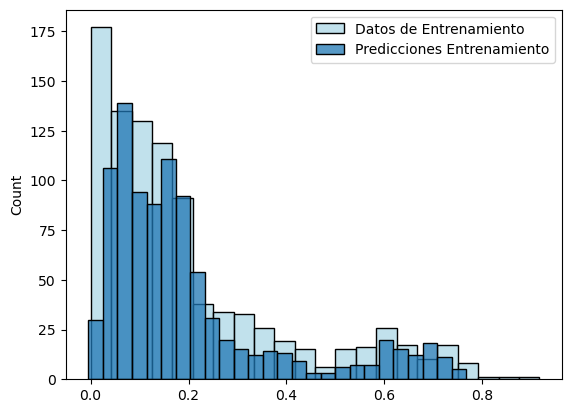

In [167]:
r2_train_8 = r2_score(y_train_desc, pred_train_desc_8)
mae_train_8 = mean_absolute_error(y_train_desc, pred_train_desc_8)
rmse_train_8 = root_mean_squared_error(y_train_desc, pred_train_desc_8)
mape_train_8 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_8)

print(f'R2 entrenamiento: {r2_train_8}')
print(f'MAE entrenamiento: {mae_train_8}')
print(f'RMSE entrenamiento: {rmse_train_8}')
print(f'MAPE entrenamiento: {mape_train_8}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_8.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.8654748303574126
MAE prueba: 0.04020222994822399
RMSE prueba: 0.06922903113156573
MAPE prueba: 0.8346603144981632


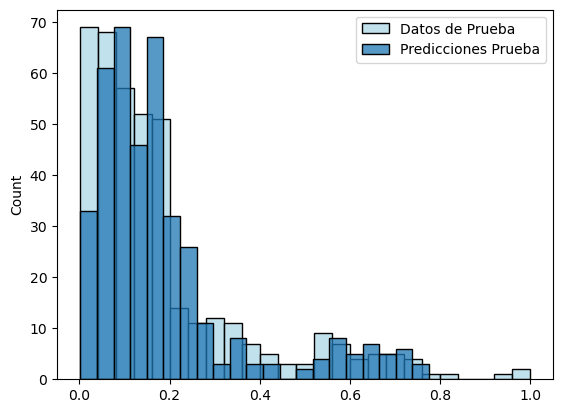

In [168]:
r2_test_8 = r2_score(y_test_desc, pred_test_desc_8)
mae_test_8 = mean_absolute_error(y_test_desc, pred_test_desc_8)
rmse_test_8 = root_mean_squared_error(y_test_desc, pred_test_desc_8)
mape_test_8 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_8)

print(f'R2 prueba: {r2_test_8}')
print(f'MAE prueba: {mae_test_8}')
print(f'RMSE prueba: {rmse_test_8}')
print(f'MAPE prueba: {mape_test_8}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_8.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Huber Regressor

In [169]:
from sklearn.linear_model import HuberRegressor

In [170]:
modelo_9 = HuberRegressor()
modelo_9.fit(X_train, y_train)

HuberRegressor()

In [171]:
pred_train_9 = modelo_9.predict(X_train)
pred_test_9 = modelo_9.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_9 = pred_train_9 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_9 = pred_test_9 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.6637235326167022
MAE entrenamiento: 0.05691644590164755
RMSE entrenamiento: 0.11303493681567871
MAPE entrenamiento: 0.39563349340502924


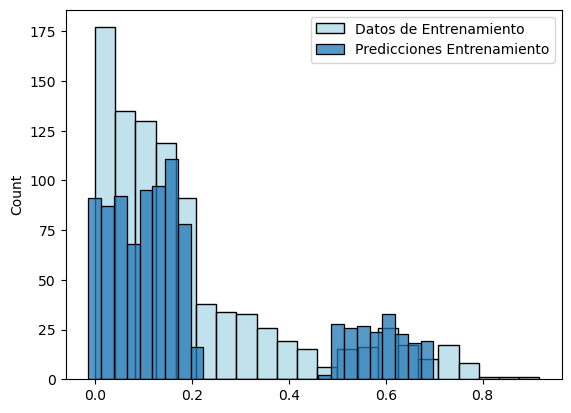

In [172]:
r2_train_9 = r2_score(y_train_desc, pred_train_desc_9)
mae_train_9 = mean_absolute_error(y_train_desc, pred_train_desc_9)
rmse_train_9 = root_mean_squared_error(y_train_desc, pred_train_desc_9)
mape_train_9 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_9)

print(f'R2 entrenamiento: {r2_train_9}')
print(f'MAE entrenamiento: {mae_train_9}')
print(f'RMSE entrenamiento: {rmse_train_9}')
print(f'MAPE entrenamiento: {mape_train_9}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_9.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.7039719285724312
MAE prueba: 0.04892732701064486
RMSE prueba: 0.10269585792444995
MAPE prueba: 0.3514371079154749


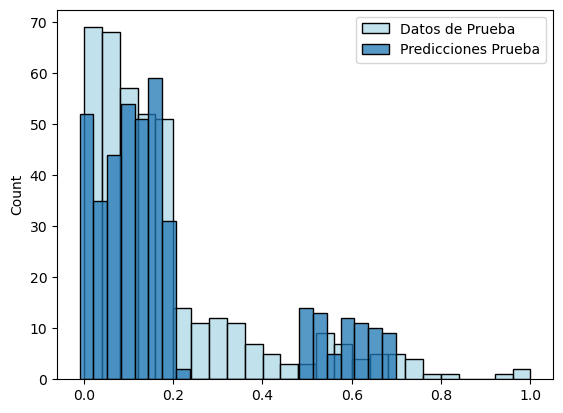

In [173]:
r2_test_9 = r2_score(y_test_desc, pred_test_desc_9)
mae_test_9 = mean_absolute_error(y_test_desc, pred_test_desc_9)
rmse_test_9 = root_mean_squared_error(y_test_desc, pred_test_desc_9)
mape_test_9 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_9)

print(f'R2 prueba: {r2_test_9}')
print(f'MAE prueba: {mae_test_9}')
print(f'RMSE prueba: {rmse_test_9}')
print(f'MAPE prueba: {mape_test_9}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_9.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### LightGBM Regressor

In [174]:
from lightgbm import LGBMRegressor

In [175]:
modelo_10 = LGBMRegressor(random_state=123)
param_grid = {'n_estimators': [100, 200, 300, 900], 'learning_rate': [0.01, 0.1, 0.5, 1], 'num_leaves': [20, 30, 40, 50], 'max_depth': [4, 6, 8]}
reg_10 = GridSearchCV(modelo_10, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)
reg_10.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_10.cv_results_['params']), 
                        pd.DataFrame(reg_10.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003281 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002879 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002501 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003412 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003004 s

,learning_rate,max_depth,n_estimators,num_leaves,MAPE
50,0.10,4,100,40,-1.083138
51,0.10,4,100,50,-1.083138
48,0.10,4,100,20,-1.083138
49,0.10,4,100,30,-1.083138
55,0.10,4,200,50,-1.097120
...,...,...,...,...,...
34,0.01,8,100,40,-3.987644
33,0.01,8,100,30,-3.987644
19,0.01,6,100,50,-3.992617
18,0.01,6,100,40,-3.992617


In [176]:
modelo_10_final = reg_10.best_estimator_
modelo_10_final

LGBMRegressor(max_depth=4, num_leaves=20, random_state=123)

In [177]:
pred_train_10 = modelo_10_final.predict(X_train)
pred_test_10 = modelo_10_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_10 = pred_train_10 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_10 = pred_test_10 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.9011484802272416
MAE entrenamiento: 0.03439957049560414
RMSE entrenamiento: 0.06128527412216638
MAPE entrenamiento: 0.7100670094286641


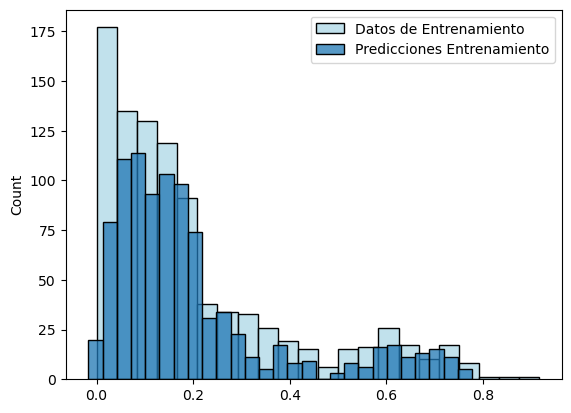

In [178]:
r2_train_10 = r2_score(y_train_desc, pred_train_desc_10)
mae_train_10 = mean_absolute_error(y_train_desc, pred_train_desc_10)
rmse_train_10 = root_mean_squared_error(y_train_desc, pred_train_desc_10)
mape_train_10 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_10)

print(f'R2 entrenamiento: {r2_train_10}')
print(f'MAE entrenamiento: {mae_train_10}')
print(f'RMSE entrenamiento: {rmse_train_10}')
print(f'MAPE entrenamiento: {mape_train_10}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_10.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.8605306167813438
MAE prueba: 0.04074216501190606
RMSE prueba: 0.07048974177387704
MAPE prueba: 0.7545360141483272


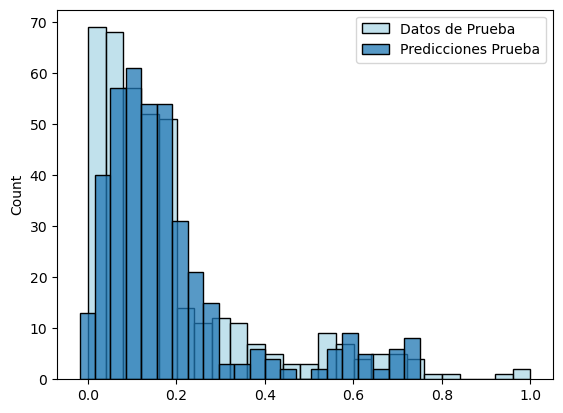

In [179]:
r2_test_10 = r2_score(y_test_desc, pred_test_desc_10)
mae_test_10 = mean_absolute_error(y_test_desc, pred_test_desc_10)
rmse_test_10 = root_mean_squared_error(y_test_desc, pred_test_desc_10)
mape_test_10 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_10)

print(f'R2 prueba: {r2_test_10}')
print(f'MAE prueba: {mae_test_10}')
print(f'RMSE prueba: {rmse_test_10}')
print(f'MAPE prueba: {mape_test_10}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_10.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Bayesian Ridge

In [180]:
from sklearn.linear_model import BayesianRidge

In [181]:
modelo_11 = BayesianRidge()
modelo_11.fit(X_train, y_train)

BayesianRidge()

In [182]:
pred_train_11 = modelo_11.predict(X_train)
pred_test_11 = modelo_11.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_11 = pred_train_11 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_11 = pred_test_11 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.7438881911973414
MAE entrenamiento: 0.06913665562136836
RMSE entrenamiento: 0.09864594994217563
MAPE entrenamiento: 1.3928072182745719


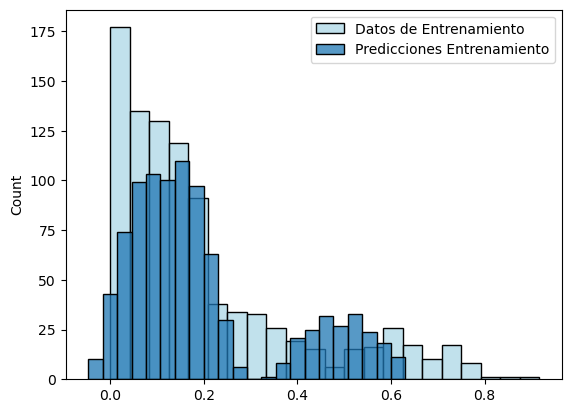

In [183]:
r2_train_11 = r2_score(y_train_desc, pred_train_desc_11)
mae_train_11 = mean_absolute_error(y_train_desc, pred_train_desc_11)
rmse_train_11 = root_mean_squared_error(y_train_desc, pred_train_desc_11)
mape_train_11 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_11)

print(f'R2 entrenamiento: {r2_train_11}')
print(f'MAE entrenamiento: {mae_train_11}')
print(f'RMSE entrenamiento: {rmse_train_11}')
print(f'MAPE entrenamiento: {mape_train_11}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_11.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.7644291675051013
MAE prueba: 0.06312124537739426
RMSE prueba: 0.09161091857902724
MAPE prueba: 1.6499887543085117


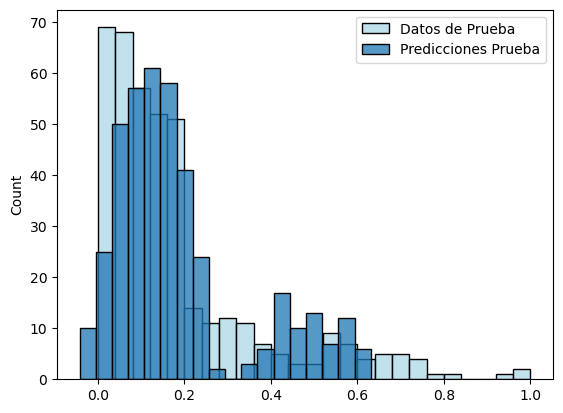

In [184]:
r2_test_11 = r2_score(y_test_desc, pred_test_desc_11)
mae_test_11 = mean_absolute_error(y_test_desc, pred_test_desc_11)
rmse_test_11 = root_mean_squared_error(y_test_desc, pred_test_desc_11)
mape_test_11 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_11)

print(f'R2 prueba: {r2_test_11}')
print(f'MAE prueba: {mae_test_11}')
print(f'RMSE prueba: {rmse_test_11}')
print(f'MAPE prueba: {mape_test_11}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_11.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

### Extra Trees Regressor

In [185]:
from sklearn.ensemble import ExtraTreesRegressor

In [186]:
modelo_12 = ExtraTreesRegressor(random_state=123)
param_grid = {'n_estimators': [100, 200, 300, 900], 'criterion': ['squared_error', 'absolute_error', 'poisson'], 'max_features': ['sqrt', 'log2', None], 'bootstrap': [False]}
reg_12 = GridSearchCV(modelo_12, param_grid, cv=3, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)
reg_12.fit(X_train, y_train)
validation = pd.concat([pd.DataFrame(reg_12.cv_results_['params']), 
                        pd.DataFrame(reg_12.cv_results_['mean_test_score'], columns= ['MAPE'])], axis = 1)
validation.sort_values('MAPE', ascending=False)

,bootstrap,criterion,max_features,n_estimators,MAPE
23,False,absolute_error,None,900,-0.666754
21,False,absolute_error,None,200,-0.667002
20,False,absolute_error,None,100,-0.668754
22,False,absolute_error,None,300,-0.672880
34,False,poisson,None,300,-1.204520
33,False,poisson,None,200,-1.221667
9,False,squared_error,None,200,-1.226090
32,False,poisson,None,100,-1.232517
35,False,poisson,None,900,-1.235235
10,False,squared_error,None,300,-1.243931


In [187]:
modelo_12_final = reg_12.best_estimator_
modelo_12_final

ExtraTreesRegressor(criterion='absolute_error', max_features=None,
                    n_estimators=900, random_state=123)

In [188]:
pred_train_12 = modelo_12_final.predict(X_train)
pred_test_12 = modelo_12_final.predict(X_test)
# Descalamiento con fórmula matemática
pred_train_desc_12 = pred_train_12 * (np.max(y) - np.min(y)) + np.min(y)
pred_test_desc_12 = pred_test_12 * (np.max(y) - np.min(y)) + np.min(y)
y_train_desc = y_train * (np.max(y) - np.min(y)) + np.min(y)
y_test_desc = y_test * (np.max(y) - np.min(y)) + np.min(y)

R2 entrenamiento: 0.9994397545118756
MAE entrenamiento: 0.00021338448245864788
RMSE entrenamiento: 0.004613745573030124
MAPE entrenamiento: 0.013379819124101949


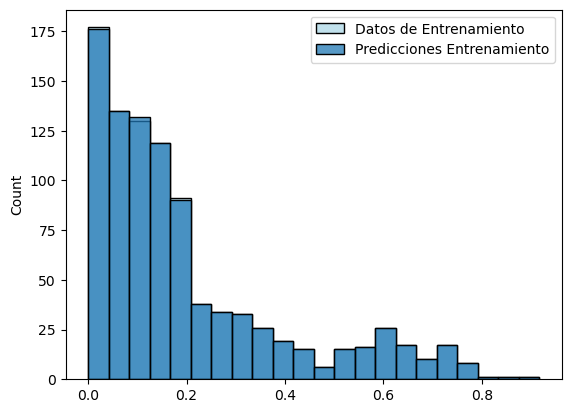

In [189]:
r2_train_12 = r2_score(y_train_desc, pred_train_desc_12)
mae_train_12 = mean_absolute_error(y_train_desc, pred_train_desc_12)
rmse_train_12 = root_mean_squared_error(y_train_desc, pred_train_desc_12)
mape_train_12 = mean_absolute_percentage_error(y_train_desc, pred_train_desc_12)

print(f'R2 entrenamiento: {r2_train_12}')
print(f'MAE entrenamiento: {mae_train_12}')
print(f'RMSE entrenamiento: {rmse_train_12}')
print(f'MAPE entrenamiento: {mape_train_12}')

sns.histplot(y_train_desc.values.flatten(), label='Datos de Entrenamiento', color='lightblue')
sns.histplot(pred_train_desc_12.flatten(), label='Predicciones Entrenamiento')
plt.legend()
plt.show()

R2 prueba: 0.7964540104851514
MAE prueba: 0.04505061915510073
RMSE prueba: 0.0851564904123515
MAPE prueba: 1.4431774704215654


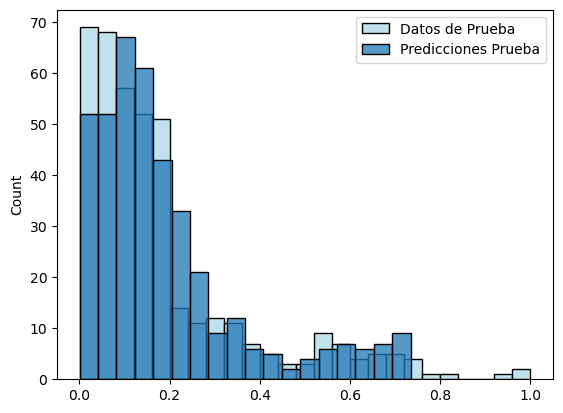

In [190]:
r2_test_12 = r2_score(y_test_desc, pred_test_desc_12)
mae_test_12 = mean_absolute_error(y_test_desc, pred_test_desc_12)
rmse_test_12 = root_mean_squared_error(y_test_desc, pred_test_desc_12)
mape_test_12 = mean_absolute_percentage_error(y_test_desc, pred_test_desc_12)

print(f'R2 prueba: {r2_test_12}')
print(f'MAE prueba: {mae_test_12}')
print(f'RMSE prueba: {rmse_test_12}')
print(f'MAPE prueba: {mape_test_12}')

sns.histplot(y_test_desc.values.flatten(), label='Datos de Prueba', color='lightblue')
sns.histplot(pred_test_desc_12.flatten(), label='Predicciones Prueba')
plt.legend()
plt.show()

## Conclusiones

A partir de los modelos evaluados se puede observar que los tres mejores resultados fueorn **Árboles de Decisión, Bosques Aleatorios, Adaptative Boosting y Gradient Boosting**

- **Árboles de Decisión:** Evaluando a partir del MAPE se obtuvo un 38% tanto para Train como para Test
- **Bosques Aleatorios:** Evaluando a partir del MAPE se obtuvo un 37% tanto para Train como para Test
- **Adaptative Boosting:** Evaluando a partir del MAPE se obtuvo un 0.01% para Train y un 15% para Test, lo cual cumple la hipótesis establecida pero se convierte en un modelo muy ajustado
- **Gradient Boosting:** Evaluando a partir del MAPE se obtuvo un 11% para Train y un 17% para Test, este modelo es el más balanceado a pesar de que no se cumple con la hipótesis del 15%

Según los modelos mencionados se determina que Gradient Boosting es el modelo a seleccionar a pesar de que no supera la hipótesis debido a que es el que presenta los mejores resultados y está más cercano al 15%